In [1]:
from sklearn.cluster import MiniBatchKMeans, SpectralClustering
from sklearn.cluster import KMeans
from sklearn.model_selection import ParameterGrid
from sklearn import metrics

In [2]:
from sklearn.decomposition import PCA
import pandas as pd 

In [3]:
#transpose matrix to have sample as row, gene in column
full_matrix_transpose = pd.read_csv(r"C:\Users\javte\Documents\SSEF project\datasets\full_matrix\matrix_logCPMrmBatch_20221207.csv", index_col=[0])
full_matrix = full_matrix_transpose.transpose()

In [4]:
full_matrix_transpose

,TCGA-AC-A8OP-01A-11R-A36F-07,TCGA-D8-A1XU-01A-11R-A14M-07,TCGA-BH-A18L-01A-32R-A12D-07,TCGA-B6-A0IK-01A-12R-A056-07,TCGA-BH-A18L-11A-42R-A12D-07,TCGA-BH-A0B1-01A-12R-A056-07,TCGA-A8-A06Q-01A-11R-A034-07,TCGA-D8-A27R-01A-11R-A16F-07,TCGA-E9-A22G-01A-11R-A157-07,TCGA-AO-A03N-01B-11R-A10J-07,...,TCGA-AC-A23H-11A-12R-A157-07,TCGA-AC-A23H-01A-11R-A157-07,TCGA-OL-A5RZ-01A-11R-A28M-07,TCGA-E2-A15M-11A-22R-A12D-07,TCGA-E9-A1RC-01A-11R-A157-07,TCGA-GM-A2DN-01A-11R-A180-07,TCGA-B6-A0I1-01A-11R-A21T-07,TCGA-EW-A1IW-01A-11R-A13Q-07,TCGA-BH-A42V-01A-11R-A24H-07,TCGA-AR-A251-01A-12R-A169-07
ENSG00000000003.15,4.334556,6.336225,3.813323,3.286383,6.045874,5.941381,3.323541,5.544895,6.921768,5.087725,...,6.986578,3.481362,5.653495,6.279134,6.897099,6.264408,7.022334,4.782851,5.099400,4.860853
ENSG00000000005.6,0.338276,-2.529474,-1.401063,-1.128756,5.275122,-3.192086,-3.253994,-1.609360,-3.171855,-4.778653,...,2.006052,-4.654663,-1.577834,3.197950,-1.315826,-3.507482,-3.436939,-0.279880,-0.877691,-1.184226
ENSG00000000419.13,5.132959,5.602467,5.565715,5.619653,4.736844,5.281138,5.770420,5.964415,4.990301,5.582393,...,4.570856,5.790502,4.620588,5.016352,5.375480,4.978926,5.271664,4.827105,4.798884,6.651349
ENSG00000000457.14,4.676303,4.319339,5.552412,4.380872,4.097760,4.673511,5.383362,4.125395,5.195532,3.946700,...,4.146447,5.794360,4.539188,3.734360,5.420498,5.489988,3.492169,4.705704,4.281478,4.888853
ENSG00000000460.17,2.458902,2.459548,4.027561,2.936265,1.781595,3.677499,3.941965,3.296232,4.705928,3.227663,...,2.069279,3.499556,2.747808,2.050792,3.702810,4.002786,3.031728,3.722578,2.446505,4.442043
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSG00000288658.1,-0.909768,-2.753690,-0.997084,-2.342148,-2.351154,-2.812540,-4.883587,-1.821303,0.665582,-4.745405,...,-1.130788,0.772475,-2.803613,-3.059240,-4.380056,-2.838586,-1.439442,-2.420443,-1.677683,1.765965
ENSG00000288663.1,0.080492,-0.438234,-1.285545,-1.807604,-0.742799,-1.586245,-0.740439,-0.332820,-1.754442,-1.836133,...,-1.011193,-1.974187,0.030127,-2.569604,-0.290967,-1.641788,-1.191216,-2.024699,-1.212881,-1.972634
ENSG00000288670.1,2.257035,2.547337,3.405424,1.726225,2.425229,3.085475,3.636666,2.765633,2.726433,1.675912,...,2.468320,1.438970,2.750470,2.200622,2.753414,2.926060,4.179808,3.735963,2.369970,1.521731
ENSG00000288674.1,-2.635427,-2.134640,-2.876473,-3.081476,-2.027311,-2.600727,-2.720115,-2.555106,-2.057346,-4.756210,...,-3.175495,-2.909171,-1.336005,-2.591459,-1.827406,-2.253647,-2.499382,-2.873014,-3.134413,-2.565941


In [4]:
#PCA
pca = PCA()
principalComponents_full_matrix = pca.fit_transform(full_matrix)
principal_full_matrix = pd.DataFrame(data = principalComponents_full_matrix
             , columns = ["PC"+str(i) for i in range(1, len(principalComponents_full_matrix)+1)])
principal_full_matrix

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC1181,PC1182,PC1183,PC1184,PC1185,PC1186,PC1187,PC1188,PC1189,PC1190
0,-41.529531,-35.536286,12.820059,-31.484378,19.773817,-32.513670,-4.087454,-12.634166,-11.718744,-6.817890,...,2.317989e-17,3.358545e-17,5.791703e-16,1.649077e-16,1.207842e-16,-1.224818e-16,3.793034e-16,3.727336e-16,1.824823e-16,3.243241e-16
1,-30.849645,-34.885648,-19.948258,-5.818903,-26.342348,-5.443753,0.730816,-9.501544,5.442128,40.762212,...,-6.188178e-17,3.673932e-16,-6.489524e-17,1.087702e-16,-2.094850e-16,3.788234e-17,-2.426625e-16,3.644510e-17,1.759674e-17,1.555889e-16
2,-78.418226,19.854948,15.898853,-12.680845,79.478587,1.994222,25.558334,-29.147747,24.209838,0.610121,...,1.568932e-15,8.630758e-16,-6.422278e-15,2.975092e-15,3.715463e-15,7.718440e-15,-4.805060e-15,-5.093584e-16,-5.498445e-15,-1.295594e-15
3,-0.647158,44.671889,-17.422569,19.704628,-23.101095,1.089484,50.680032,-16.956449,24.462791,14.496685,...,1.291410e-15,2.931907e-15,-5.600847e-15,-1.360095e-15,-3.764622e-16,-4.055161e-16,1.815167e-15,2.982956e-15,2.053144e-15,9.697177e-16
4,120.544090,-103.044179,26.564522,21.747705,16.296654,20.622125,3.055648,-7.060247,-1.653002,25.058082,...,-5.550099e-15,1.110147e-14,3.710228e-15,-5.997150e-15,5.095338e-15,7.849914e-15,-2.757180e-15,-4.197865e-15,-3.942240e-15,-7.379722e-16
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1185,1.035255,13.323431,-47.580004,-13.868561,-40.730068,13.011782,-3.382857,34.993261,23.884929,1.735323,...,-4.091812e-15,2.674251e-14,5.330123e-14,1.197343e-14,-3.312677e-15,-4.326071e-14,-1.063099e-13,7.763225e-14,-3.010056e-14,-1.598299e-15
1186,18.555666,118.795795,84.621350,-10.018949,-32.533448,45.363509,3.820415,-8.465570,-39.989270,14.602175,...,6.509247e-14,-4.040622e-14,2.150186e-14,8.451506e-15,-4.299806e-14,-6.280126e-14,6.707138e-14,-3.904383e-15,-2.971142e-14,9.286915e-15
1187,7.798277,-10.379151,-17.558302,9.708061,-20.251964,0.311278,-13.906083,-22.811422,5.688717,-4.103402,...,-1.395001e-15,1.319867e-15,1.122549e-15,4.139985e-15,-7.714813e-16,-5.106735e-15,-1.200073e-14,8.985181e-15,-2.228702e-15,-2.444662e-16
1188,14.265547,-23.708248,-11.673175,-5.807948,-0.435083,-4.480856,-10.318374,-21.636932,20.031965,-20.028766,...,-1.942894e-15,6.211454e-14,-3.166615e-14,7.008026e-16,-3.089567e-15,-7.692376e-15,-2.187723e-15,-1.700829e-15,1.233177e-14,3.165304e-15


In [5]:
# Take pam50 column from metadata and set as index of PCA dataframe
unsorted_metadata = pd.read_csv(r"C:\Users\javte\Documents\SSEF project\datasets\Normalized expression data set\metadata\selected_metadat_20221128.csv")
full_matrix_pam50 = unsorted_metadata[('pam50')].to_list()
principal_full_matrix['pam50'] = full_matrix_pam50
principal_full_matrix

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC1182,PC1183,PC1184,PC1185,PC1186,PC1187,PC1188,PC1189,PC1190,pam50
0,-41.529531,-35.536286,12.820059,-31.484378,19.773817,-32.513670,-4.087454,-12.634166,-11.718744,-6.817890,...,3.358545e-17,5.791703e-16,1.649077e-16,1.207842e-16,-1.224818e-16,3.793034e-16,3.727336e-16,1.824823e-16,3.243241e-16,LumA
1,-30.849645,-34.885648,-19.948258,-5.818903,-26.342348,-5.443753,0.730816,-9.501544,5.442128,40.762212,...,3.673932e-16,-6.489524e-17,1.087702e-16,-2.094850e-16,3.788234e-17,-2.426625e-16,3.644510e-17,1.759674e-17,1.555889e-16,LumA
2,-78.418226,19.854948,15.898853,-12.680845,79.478587,1.994222,25.558334,-29.147747,24.209838,0.610121,...,8.630758e-16,-6.422278e-15,2.975092e-15,3.715463e-15,7.718440e-15,-4.805060e-15,-5.093584e-16,-5.498445e-15,-1.295594e-15,LumB
3,-0.647158,44.671889,-17.422569,19.704628,-23.101095,1.089484,50.680032,-16.956449,24.462791,14.496685,...,2.931907e-15,-5.600847e-15,-1.360095e-15,-3.764622e-16,-4.055161e-16,1.815167e-15,2.982956e-15,2.053144e-15,9.697177e-16,Her2
4,120.544090,-103.044179,26.564522,21.747705,16.296654,20.622125,3.055648,-7.060247,-1.653002,25.058082,...,1.110147e-14,3.710228e-15,-5.997150e-15,5.095338e-15,7.849914e-15,-2.757180e-15,-4.197865e-15,-3.942240e-15,-7.379722e-16,Healthy
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1185,1.035255,13.323431,-47.580004,-13.868561,-40.730068,13.011782,-3.382857,34.993261,23.884929,1.735323,...,2.674251e-14,5.330123e-14,1.197343e-14,-3.312677e-15,-4.326071e-14,-1.063099e-13,7.763225e-14,-3.010056e-14,-1.598299e-15,LumA
1186,18.555666,118.795795,84.621350,-10.018949,-32.533448,45.363509,3.820415,-8.465570,-39.989270,14.602175,...,-4.040622e-14,2.150186e-14,8.451506e-15,-4.299806e-14,-6.280126e-14,6.707138e-14,-3.904383e-15,-2.971142e-14,9.286915e-15,Basal
1187,7.798277,-10.379151,-17.558302,9.708061,-20.251964,0.311278,-13.906083,-22.811422,5.688717,-4.103402,...,1.319867e-15,1.122549e-15,4.139985e-15,-7.714813e-16,-5.106735e-15,-1.200073e-14,8.985181e-15,-2.228702e-15,-2.444662e-16,LumA
1188,14.265547,-23.708248,-11.673175,-5.807948,-0.435083,-4.480856,-10.318374,-21.636932,20.031965,-20.028766,...,6.211454e-14,-3.166615e-14,7.008026e-16,-3.089567e-15,-7.692376e-15,-2.187723e-15,-1.700829e-15,1.233177e-14,3.165304e-15,LumA


In [322]:
principal_full_matrix_pca2 = principal_full_matrix[['PC1','PC2','PC3','PC4']]
pca_df = principal_full_matrix_pca2 #reassign

In [7]:
parameters = [3, 4, 5, 6, 7, 8, 9, 10, 11]
parameter_grid = ParameterGrid({'n_clusters': parameters})
kmeans_model = MiniBatchKMeans(n_clusters=8, 
                               init='k-means++', 
                               max_iter=100, 
                               batch_size=1024, 
                               verbose=1, 
                               max_no_improvement=10, 
                               init_size=None)

In [8]:
k_predictions = []
for p in parameter_grid:
    kmeans_model.set_params(**p)    
    kmeans_model.fit(pca_df)
    k_predictions += [kmeans_model.fit_predict(pca_df)]

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Init 1/3 with method k-means++
Inertia for init 1/3: 5364571.190616629
Init 2/3 with method k-means++
Inertia for init 2/3: 2968448.9973970987
Init 3/3 with method k-means++
Inertia for init 3/3: 3912553.882712505
Minibatch step 1/116: mean batch inertia: 2511.667010868143
Minibatch step 2/116: mean batch inertia: 2249.113727879329, ewa inertia: 2249.113727879329
Minibatch step 3/116: mean batch inertia: 2232.2241295418435, ewa inertia: 2232.2241295418435
Minibatch step 4/116: mean batch inertia: 2200.735123954163, ewa inertia: 2200.735123954163
Minibatch step 5/116: mean batch inertia: 2287.3152018629044, ewa inertia: 2287.3152018629044
Minibatch step 6/116: mean batch inertia: 2217.174841127521, ewa inertia: 2217.174841127521
Minibatch step 7/116: mean batch inertia: 2225.6771925740204, ewa inertia: 2225.6771925740204
Minibatch step 8/116: mean batch inertia: 2353.4036192161902, ewa inertia: 2353.4036192161902
Minibatch step 9/116: mean batch inertia: 2239.8729876153893, ewa inertia:

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Init 1/3 with method k-means++
Inertia for init 1/3: 2443545.0947815618
Init 2/3 with method k-means++
Inertia for init 2/3: 2858553.044337891
Init 3/3 with method k-means++
Inertia for init 3/3: 2446933.5217126855
Minibatch step 1/116: mean batch inertia: 1898.201196005834
Minibatch step 2/116: mean batch inertia: 1846.2944745240989, ewa inertia: 1846.2944745240989
Minibatch step 3/116: mean batch inertia: 1739.0819976500982, ewa inertia: 1739.0819976500982
Minibatch step 4/116: mean batch inertia: 1666.1226762336296, ewa inertia: 1666.1226762336296
Minibatch step 5/116: mean batch inertia: 1696.0352878206036, ewa inertia: 1696.0352878206036
Minibatch step 6/116: mean batch inertia: 1602.994055238155, ewa inertia: 1602.994055238155
Minibatch step 7/116: mean batch inertia: 1680.1789335176175, ewa inertia: 1680.1789335176175
Minibatch step 8/116: mean batch inertia: 1641.9775813661436, ewa inertia: 1641.9775813661436
Minibatch step 9/116: mean batch inertia: 1623.9382599185358, ewa ine

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Inertia for init 3/3: 2099683.1043770583
Minibatch step 1/116: mean batch inertia: 1699.9298022279418
Minibatch step 2/116: mean batch inertia: 1340.278759649058, ewa inertia: 1340.278759649058
Minibatch step 3/116: mean batch inertia: 1274.0453671842647, ewa inertia: 1274.0453671842647
Minibatch step 4/116: mean batch inertia: 1272.6337013802734, ewa inertia: 1272.6337013802734
Minibatch step 5/116: mean batch inertia: 1223.2473687505358, ewa inertia: 1223.2473687505358
Minibatch step 6/116: mean batch inertia: 1272.952978481067, ewa inertia: 1272.952978481067
Minibatch step 7/116: mean batch inertia: 1223.761591958475, ewa inertia: 1223.761591958475
Minibatch step 8/116: mean batch inertia: 1226.2257958814682, ewa inertia: 1226.2257958814682
Minibatch step 9/116: mean batch inertia: 1276.3128030121832, ewa inertia: 1276.3128030121832
Minibatch step 10/116: mean batch inertia: 1184.481512143478, ewa inertia: 1184.481512143478
Minibatch step 11/116: mean batch inertia: 1148.38512066344

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Inertia for init 2/3: 1418617.1162432916
Init 3/3 with method k-means++
Inertia for init 3/3: 1380150.1954043263
Minibatch step 1/116: mean batch inertia: 1151.8474033300513
Minibatch step 2/116: mean batch inertia: 1090.6242679554423, ewa inertia: 1090.6242679554423
Minibatch step 3/116: mean batch inertia: 1031.240991720171, ewa inertia: 1031.240991720171
Minibatch step 4/116: mean batch inertia: 968.5782010193642, ewa inertia: 968.5782010193642
Minibatch step 5/116: mean batch inertia: 1065.158942291116, ewa inertia: 1065.158942291116
Minibatch step 6/116: mean batch inertia: 1047.616724834061, ewa inertia: 1047.616724834061
Minibatch step 7/116: mean batch inertia: 978.4721923468385, ewa inertia: 978.4721923468385
Minibatch step 8/116: mean batch inertia: 1035.8039376821196, ewa inertia: 1035.8039376821196
Minibatch step 9/116: mean batch inertia: 985.2732151578135, ewa inertia: 985.2732151578135
Minibatch step 10/116: mean batch inertia: 1037.7399590920343, ewa inertia: 1037.73995

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Inertia for init 1/3: 1491787.3423301063
Init 2/3 with method k-means++
Inertia for init 2/3: 1261947.365507649
Init 3/3 with method k-means++
Inertia for init 3/3: 1404509.0563702723
Minibatch step 1/116: mean batch inertia: 1076.2921092235658
Minibatch step 2/116: mean batch inertia: 921.9059513018357, ewa inertia: 921.9059513018357
Minibatch step 3/116: mean batch inertia: 950.1315152658913, ewa inertia: 950.1315152658913
Minibatch step 4/116: mean batch inertia: 906.1552273437734, ewa inertia: 906.1552273437734
Minibatch step 5/116: mean batch inertia: 916.9468425522477, ewa inertia: 916.9468425522477
Minibatch step 6/116: mean batch inertia: 864.9150468484412, ewa inertia: 864.9150468484412
Minibatch step 7/116: mean batch inertia: 866.4274978999338, ewa inertia: 866.4274978999338
Minibatch step 8/116: mean batch inertia: 899.6560171815925, ewa inertia: 899.6560171815925
Minibatch step 9/116: mean batch inertia: 918.2773962369736, ewa inertia: 918.2773962369736
Minibatch step 10/1

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Minibatch step 32/116: mean batch inertia: 807.9044828642105, ewa inertia: 807.9044828642105
Minibatch step 33/116: mean batch inertia: 830.6575231578447, ewa inertia: 830.6575231578447
Minibatch step 34/116: mean batch inertia: 870.9698598202427, ewa inertia: 870.9698598202427
Minibatch step 35/116: mean batch inertia: 838.0813374423506, ewa inertia: 838.0813374423506
Minibatch step 36/116: mean batch inertia: 782.7337448963967, ewa inertia: 782.7337448963967
Minibatch step 37/116: mean batch inertia: 787.5952382995415, ewa inertia: 787.5952382995415
Minibatch step 38/116: mean batch inertia: 827.7283566360784, ewa inertia: 827.7283566360784
Minibatch step 39/116: mean batch inertia: 818.4557556804477, ewa inertia: 818.4557556804477
Minibatch step 40/116: mean batch inertia: 878.6346640073436, ewa inertia: 878.6346640073436
Minibatch step 41/116: mean batch inertia: 822.8923903312115, ewa inertia: 822.8923903312115
Minibatch step 42/116: mean batch inertia: 826.0580240275543, ewa iner

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Inertia for init 3/3: 1216484.5429500719
Minibatch step 1/116: mean batch inertia: 853.8315545009345
Minibatch step 2/116: mean batch inertia: 729.896764989774, ewa inertia: 729.896764989774
Minibatch step 3/116: mean batch inertia: 700.8282479207709, ewa inertia: 700.8282479207709
Minibatch step 4/116: mean batch inertia: 708.4481000490227, ewa inertia: 708.4481000490227
Minibatch step 5/116: mean batch inertia: 747.7002649129621, ewa inertia: 747.7002649129621
Minibatch step 6/116: mean batch inertia: 695.1756245269826, ewa inertia: 695.1756245269826
Minibatch step 7/116: mean batch inertia: 687.5134505390234, ewa inertia: 687.5134505390234
Minibatch step 8/116: mean batch inertia: 711.0689186230716, ewa inertia: 711.0689186230716
Minibatch step 9/116: mean batch inertia: 698.7760022397745, ewa inertia: 698.7760022397745
Minibatch step 10/116: mean batch inertia: 725.7260595828596, ewa inertia: 725.7260595828596
Minibatch step 11/116: mean batch inertia: 671.938123001847, ewa inertia

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Init 1/3 with method k-means++
Inertia for init 1/3: 899356.8180249782
Init 2/3 with method k-means++
Inertia for init 2/3: 1063349.5164312692
Init 3/3 with method k-means++
Inertia for init 3/3: 894027.458500747
Minibatch step 1/116: mean batch inertia: 816.5988115399359
Minibatch step 2/116: mean batch inertia: 698.6700618861535, ewa inertia: 698.6700618861535
Minibatch step 3/116: mean batch inertia: 669.7018363379476, ewa inertia: 669.7018363379476
Minibatch step 4/116: mean batch inertia: 639.3739577511853, ewa inertia: 639.3739577511853
Minibatch step 5/116: mean batch inertia: 674.4184356749001, ewa inertia: 674.4184356749001
Minibatch step 6/116: mean batch inertia: 641.8632097605121, ewa inertia: 641.8632097605121
Minibatch step 7/116: mean batch inertia: 641.6878848509738, ewa inertia: 641.6878848509738
Minibatch step 8/116: mean batch inertia: 631.679040488229, ewa inertia: 631.679040488229
Minibatch step 9/116: mean batch inertia: 639.2119303114964, ewa inertia: 639.2119303

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 1280 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


Minibatch step 1/116: mean batch inertia: 697.7693511186983
Minibatch step 2/116: mean batch inertia: 630.9904244831733, ewa inertia: 630.9904244831733
Minibatch step 3/116: mean batch inertia: 641.719943493169, ewa inertia: 641.719943493169
Minibatch step 4/116: mean batch inertia: 641.7298421768958, ewa inertia: 641.7298421768958
Minibatch step 5/116: mean batch inertia: 620.5461410187853, ewa inertia: 620.5461410187853
Minibatch step 6/116: mean batch inertia: 668.319681151063, ewa inertia: 668.319681151063
Minibatch step 7/116: mean batch inertia: 624.7319659874267, ewa inertia: 624.7319659874267
Minibatch step 8/116: mean batch inertia: 648.3384559384593, ewa inertia: 648.3384559384593
Minibatch step 9/116: mean batch inertia: 638.8279250127339, ewa inertia: 638.8279250127339
Minibatch step 10/116: mean batch inertia: 651.66223514086, ewa inertia: 651.66223514086
Minibatch step 11/116: mean batch inertia: 611.7797035985363, ewa inertia: 611.7797035985363
Minibatch step 12/116: mea

In [23]:
pca_df_predict = pca_df
for i in range (0,(len(k_predictions))):
    make_predict = [pca_df_predict,pd.Series(k_predictions[i]).rename(f'{i+3}')]
    pca_df_predict = pd.concat(make_predict,axis=1)
kcluster_result=pca_df_predict.iloc[:,2:11]

In [107]:
#to visualise k-sweep
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
fig,axes = plt.subplots(3,3,dpi=600,figsize=(16,16))
i=0
for i, ax in enumerate(fig.axes): 
    sns.scatterplot(ax=ax,x=pca_df_predict['PC1'],y=pca_df_predict['PC2'],hue=pca_df_predict.iloc[:,i+2],palette='Spectral',legend='full')
    i+=1

In [361]:
display(pd.DataFrame(comatrix))
display(kcluster_result)

,0,1,2,3,4,5,6,7,8,9,...,1180,1181,1182,1183,1184,1185,1186,1187,1188,1189
0,1.000000,0.777778,0.333333,0.111111,0.0,0.444444,0.333333,0.222222,0.000000,0.222222,...,0.0,0.222222,0.222222,0.0,0.333333,0.111111,0.000000,0.111111,0.111111,0.000000
1,0.777778,1.000000,0.111111,0.111111,0.0,0.555556,0.111111,0.111111,0.000000,0.111111,...,0.0,0.111111,0.111111,0.0,0.111111,0.222222,0.000000,0.333333,0.333333,0.000000
2,0.333333,0.111111,1.000000,0.111111,0.0,0.111111,0.888889,0.222222,0.000000,0.555556,...,0.0,0.333333,0.555556,0.0,0.777778,0.111111,0.000000,0.111111,0.111111,0.000000
3,0.111111,0.111111,0.111111,1.000000,0.0,0.222222,0.111111,0.888889,0.111111,0.555556,...,0.0,0.777778,0.555556,0.0,0.111111,0.444444,0.111111,0.111111,0.111111,0.111111
4,0.000000,0.000000,0.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,...,1.0,0.000000,0.000000,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1185,0.111111,0.222222,0.111111,0.444444,0.0,0.666667,0.111111,0.444444,0.000000,0.333333,...,0.0,0.444444,0.333333,0.0,0.111111,1.000000,0.000000,0.666667,0.444444,0.000000
1186,0.000000,0.000000,0.000000,0.111111,0.0,0.000000,0.000000,0.000000,0.777778,0.000000,...,0.0,0.000000,0.000000,0.0,0.000000,0.000000,1.000000,0.000000,0.000000,0.666667
1187,0.111111,0.333333,0.111111,0.111111,0.0,0.555556,0.111111,0.111111,0.000000,0.111111,...,0.0,0.111111,0.111111,0.0,0.111111,0.666667,0.000000,1.000000,0.777778,0.000000
1188,0.111111,0.333333,0.111111,0.111111,0.0,0.444444,0.111111,0.111111,0.000000,0.111111,...,0.0,0.111111,0.111111,0.0,0.111111,0.444444,0.000000,0.777778,1.000000,0.000000


,3,4,5,6,7,8,9,10,11
0,0,0,4,5,2,5,0,0,7
1,0,3,3,5,2,5,0,0,7
2,0,0,4,2,5,3,5,8,10
3,0,2,0,0,4,4,3,5,4
4,1,1,1,1,1,2,2,2,2
...,...,...,...,...,...,...,...,...,...
1185,0,3,0,0,4,0,8,9,0
1186,2,2,2,3,0,1,7,1,6
1187,0,3,3,4,3,0,8,9,0
1188,0,3,3,4,3,0,6,3,0


In [27]:
def compareList(list_current, list_compare):
    count = 0
    for a,b in zip(list_current,list_compare):
        if a==b:
            count+=1
    return(count/(len(list_current)))

0.7777777777777778

In [47]:
%time
cooccurrence=[]
for i in range(0,(len(kcluster_result))):
    row_current = kcluster_result.iloc[i,:]
    for j in range(0,len(kcluster_result)):
        row_compare = kcluster_result.iloc[j,:]
        cooccurrence+=[compareList(list(row_current),list(row_compare))]

CPU times: total: 0 ns
Wall time: 0 ns


In [169]:
comatrix = (np.array(cooccurrence)).reshape(1190,1190)
fig,axes = plt.subplots(1,1,dpi=800,figsize=(30,30))
sns.heatmap(comatrix)

<AxesSubplot: >

In [82]:
all(full_matrix_pam50 == unsorted_metadata.pam50)

True

C:\Users\javte\anaconda3\envs\ev_2\lib\site-packages\seaborn\matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


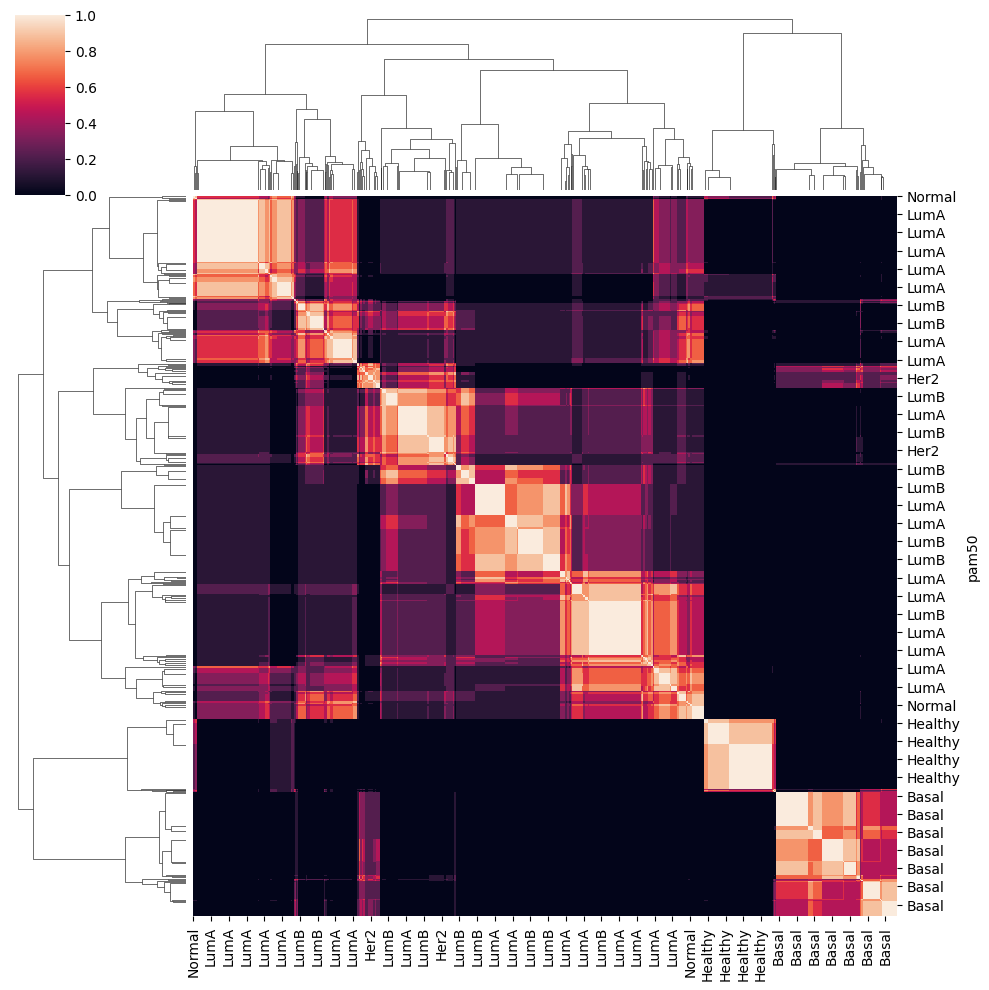

In [99]:
matrix_df = pd.DataFrame(data=comatrix,columns=full_matrix_pam50)
matrix_df['pam50']=full_matrix_pam50
matrix_df.set_index('pam50',inplace=True)
sns.clustermap(matrix_df)

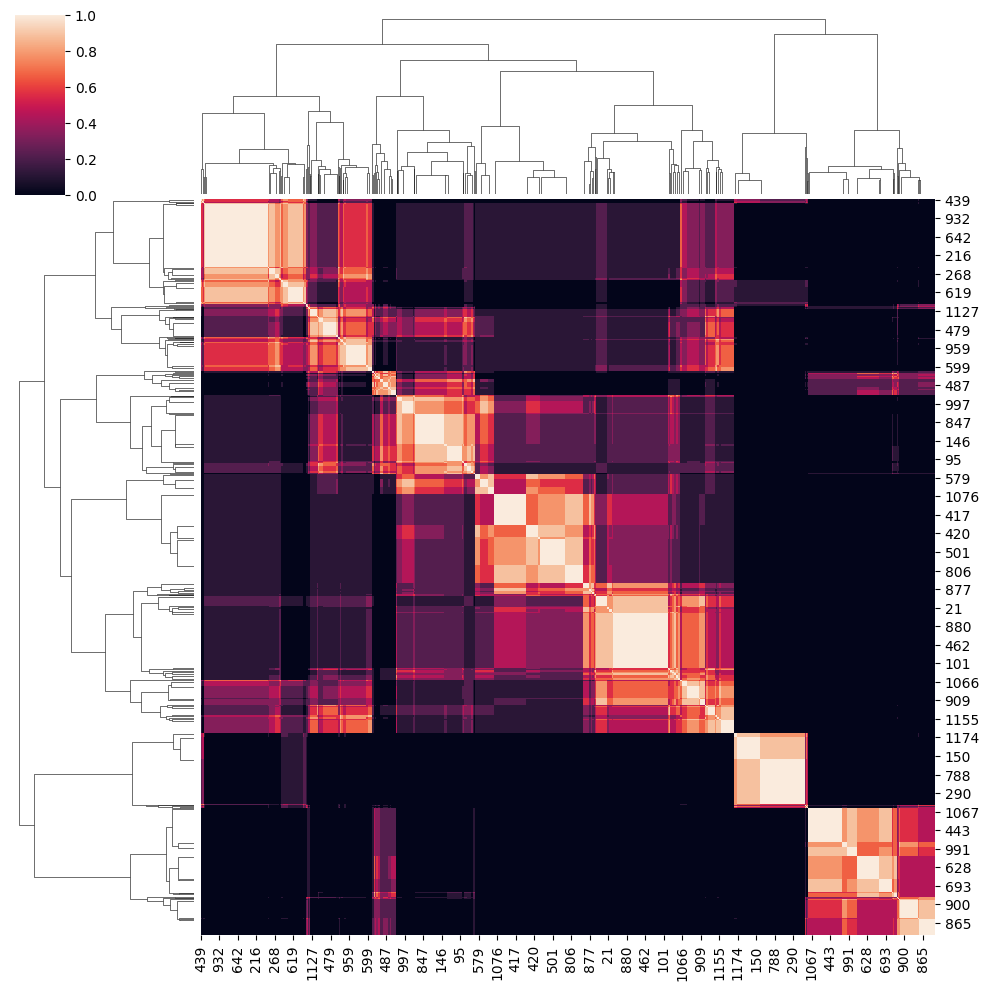

In [89]:
sns.clustermap(comatrix)

In [102]:
def vote(score):
    if score < 0.5:
        score = 0
    else: score = 1
    return score

In [103]:
majVote = np.vectorize(vote)
comatrix_voted = majVote(comatrix)

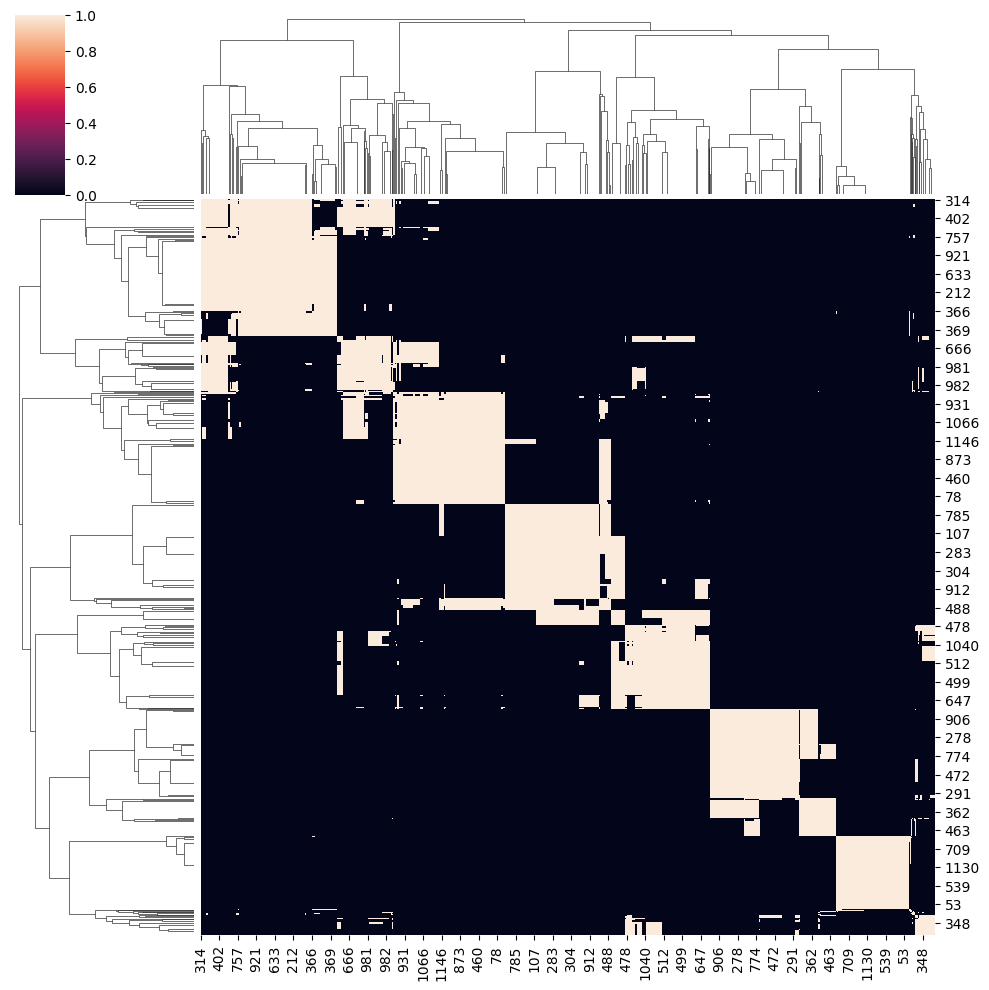

In [104]:
sns.clustermap(comatrix_voted)

In [108]:
from sksurv.nonparametric import kaplan_meier_estimator
metadata = pd.read_excel(r"C:\Users\javte\Documents\SSEF project\datasets\big metadata\sel_metadat_15Dec22.xlsx")

<AxesSubplot: >

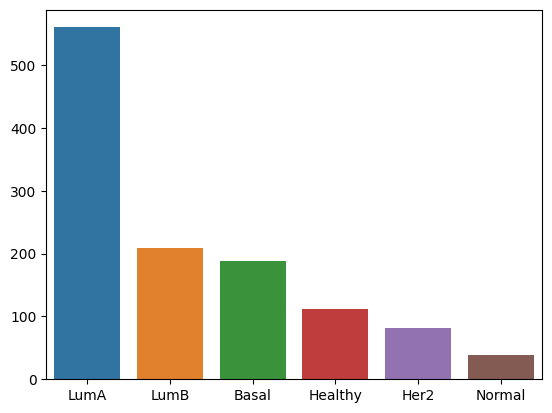

In [356]:
sns.barplot(pd.DataFrame(principal_full_matrix.pam50.value_counts()).T)

<AxesSubplot: xlabel='PC1', ylabel='PC2'>

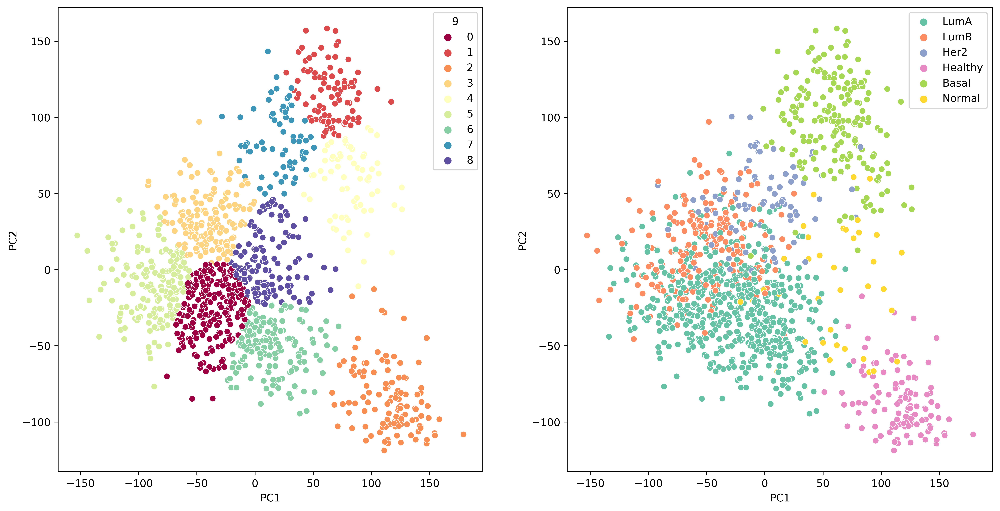

In [362]:
fig,axes=plt.subplots(1,2,dpi=600,figsize=(16,8))
sns.scatterplot(ax=axes[0],x=pca_df_predict['PC1'],y=pca_df_predict['PC2'],hue=pca_df_predict['9'],palette='Spectral',legend='full')
sns.scatterplot(ax=axes[1],x=principal_full_matrix_pca2['PC1'],y=principal_full_matrix_pca2['PC2'],hue=full_matrix_pam50,
               palette='Set2')

In [117]:
metadataTemp = metadata

In [139]:
toJoin = [metadataTemp,pca_df_predict['9']]
metadataCompare = pd.concat(toJoin,axis=1)
metadataCompare = metadataCompare[['pam50',
                                  '9',
                                 'days_to_collection',
                                 'vital_status']]
metadataCompare = metadataCompare.rename(columns={'9':'kmeans9'})
deadOrAlive = dict({'Alive' : True, 'Dead' : False})
metadataCompare = metadataCompare.replace({'vital_status' : deadOrAlive})
metadataCompare['days_to_collection'] = metadataCompare['days_to_collection'].fillna(0)

Text(0, 0.5, '${S}(t)$')

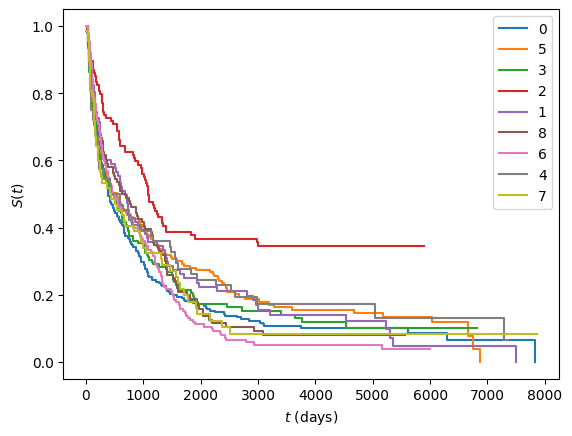

In [147]:
for cluster in list(metadataCompare['kmeans9'].unique()):
    survival_type_df = metadataCompare.query('kmeans9 == @cluster')
    time, survival_prob = kaplan_meier_estimator(survival_type_df['vital_status'], survival_type_df['days_to_collection'])
    plt.step(time, survival_prob, where="post",
             label="%s" % cluster)
plt.legend(loc='best')
plt.xlabel(r'$t$ (days)');plt.ylabel(r'${S}(t)$')

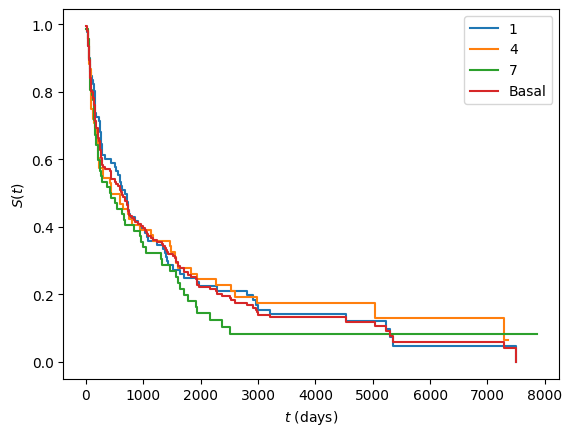

In [162]:
basal_kmeans9 = [1,4,7]
metadataFiltered = metadataCompare.query('kmeans9 == @basal_kmeans9')
for cluster in basal_kmeans9:
    survival_type_df = metadataCompare.query('kmeans9 == @cluster')
    time, survival_prob = kaplan_meier_estimator(survival_type_df['vital_status'], survival_type_df['days_to_collection'])
    plt.step(time, survival_prob, where="post",
             label="%s" % cluster)
plt.xlabel(r'$t$ (days)');plt.ylabel(r'${S}(t)$')
survival_basal = metadataCompare.query('pam50 == "Basal"')
time_basal, survival_prob_basal = kaplan_meier_estimator(survival_basal['vital_status'], survival_basal['days_to_collection'])
plt.step(time_basal, survival_prob_basal, where="post",label="Basal")
plt.legend(loc='best')

In [212]:
full_matrix_kmeans9 = pd.concat([full_matrix.reset_index().drop('index',axis=1)
                                 ,pd.Series(pca_df_predict['9']),principal_full_matrix.pam50],axis=1)
full_matrix_kmeans9 = full_matrix_kmeans9.rename(columns={'9':'kmeans9'})
full_matrix_kmeans9_basal = full_matrix_kmeans9.query('kmeans9 == @basal_kmeans9 or pam50=="Healthy"')
display(full_matrix_kmeans9_basal.head())

,ENSG00000000003.15,ENSG00000000005.6,ENSG00000000419.13,ENSG00000000457.14,ENSG00000000460.17,ENSG00000000938.13,ENSG00000000971.16,ENSG00000001036.14,ENSG00000001084.13,ENSG00000001167.14,...,ENSG00000288605.1,ENSG00000288611.1,ENSG00000288612.1,ENSG00000288658.1,ENSG00000288663.1,ENSG00000288670.1,ENSG00000288674.1,ENSG00000288675.1,kmeans9,pam50
4,6.045874,5.275122,4.736844,4.097760,1.781595,3.652715,7.783962,5.549929,5.483536,4.849457,...,-0.806703,-4.730254,0.256799,-2.351154,-0.742799,2.425229,-2.027311,-1.763284,2,Healthy
8,6.921768,-3.171855,4.990301,5.195532,4.705928,2.391717,3.583524,5.580440,5.140992,7.212659,...,3.283424,-3.495349,-0.140576,0.665582,-1.754442,2.726433,-2.057346,-0.872842,1,Basal
15,6.446731,1.698619,4.791872,4.803093,2.197670,1.733086,3.695348,4.159359,4.995181,5.266088,...,1.010878,-4.717169,-0.412914,-3.599901,-0.943520,2.547722,-2.673867,-1.255934,2,Healthy
16,6.348063,0.949072,4.754011,4.459150,4.501956,3.978350,5.629570,4.834164,4.980365,5.849691,...,-0.466663,-2.477738,-0.531892,-3.226408,-1.094583,2.481838,-2.304486,-1.191663,4,Basal
30,5.309881,-3.385129,5.302892,4.588367,3.691815,3.504740,6.126163,5.243491,3.910847,5.857799,...,-4.650051,2.117456,-0.639494,-0.482757,-1.967535,1.887763,-3.550205,1.615666,7,Her2


In [271]:
X_basal1_full = full_matrix_kmeans9_basal.query('kmeans9 == 1 or pam50 == "Healthy"')
X_basal1 = X_basal1_full.iloc[:,:26991].reset_index().drop('index',axis=1)
y_basal1 = X_basal1_full.iloc[:,26991:]
y_basal1['pam50'].replace('Healthy',0,inplace=True)
y_basal1['pam50'].replace('Basal',1,inplace=True)
y_basal1=y_basal1['pam50'].reset_index()['pam50']

In [274]:
from sklearn.ensemble import RandomForestClassifier
from boruta import BorutaPy
#random forest estimator

random_forest_estimator = RandomForestClassifier(random_state=77, max_depth=5)
boruta_selector = BorutaPy(estimator=random_forest_estimator, 
                           n_estimators='auto', verbose=2, 
                           random_state=77, 
                           max_iter=100, 
                           alpha=0.0001)

boruta_selector.fit(np.array(X_basal1),np.array(y_basal1))

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	9 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	10 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	11 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	12 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	13 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	14 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	15 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	16 / 10

BorutaPy(alpha=0.0001,
         estimator=RandomForestClassifier(max_depth=5, n_estimators=609,
                                          random_state=RandomState(MT19937) at 0x24A69EAB140),
         n_estimators='auto',
         random_state=RandomState(MT19937) at 0x24A69EAB140, verbose=2)

In [279]:
X_basal1_important = boruta_selector.transform(np.array(X_basal1))

In [281]:
rf_basal1 = RandomForestClassifier(random_state=77,n_estimators=1000,max_depth=5,verbose=1)
rf_basal1.fit(X_basal1_important, y_basal1)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1000 out of 1000 | elapsed:    0.4s finished


RandomForestClassifier(max_depth=5, n_estimators=1000, random_state=77,
                       verbose=1)

In [298]:
selected_genes_basal1 = pd.DataFrame({'Feature':list(X_basal1.columns),
                                     'Ranking':boruta_selector.ranking_}).query('Ranking == 1')
feature_importances_basal1 = pd.Series(rf_basal1.feature_importances_,index=selected_genes_basal1['Feature']).sort_values(ascending=False)
feature_importances_basal1.index.to_list()

['ENSG00000142945.13',
 'ENSG00000149575.9',
 'ENSG00000088325.16',
 'ENSG00000284753.2',
 'ENSG00000255471.1',
 'ENSG00000241684.6',
 'ENSG00000134690.11',
 'ENSG00000154839.10',
 'ENSG00000108106.14',
 'ENSG00000115163.15',
 'ENSG00000166851.15',
 'ENSG00000168497.5',
 'ENSG00000051180.17',
 'ENSG00000117399.14',
 'ENSG00000132646.11',
 'ENSG00000165197.5',
 'ENSG00000105011.9',
 'ENSG00000146670.10',
 'ENSG00000018625.15',
 'ENSG00000143228.13',
 'ENSG00000175063.17',
 'ENSG00000160957.14',
 'ENSG00000127423.11',
 'ENSG00000143321.19',
 'ENSG00000129810.15',
 'ENSG00000093009.11',
 'ENSG00000078596.11',
 'ENSG00000090889.12',
 'ENSG00000141338.14',
 'ENSG00000138180.16',
 'ENSG00000123975.5',
 'ENSG00000197275.14',
 'ENSG00000157456.8',
 'ENSG00000197776.8',
 'ENSG00000127564.17',
 'ENSG00000103257.9',
 'ENSG00000186185.14',
 'ENSG00000136546.16',
 'ENSG00000277631.5',
 'ENSG00000152583.12',
 'ENSG00000271936.1',
 'ENSG00000149554.13',
 'ENSG00000101447.15',
 'ENSG00000089685.15',
 

In [306]:
X_basal4_full = full_matrix_kmeans9_basal.query('kmeans9 == 4 or pam50 == "Healthy"')
X_basal4 = X_basal4_full.iloc[:,:26991].reset_index().drop('index',axis=1)
y_basal4 = X_basal4_full.iloc[:,26991:]
y_basal4['pam50'].replace('Healthy',0,inplace=True)
y_basal4['pam50'].replace('Basal',1,inplace=True)
y_basal4['pam50'].replace('Her2',1,inplace=True)
y_basal4['pam50'].replace('Normal',1,inplace=True)
y_basal4=y_basal4['pam50'].reset_index()['pam50']

In [307]:
boruta_selector.fit(np.array(X_basal4),np.array(y_basal4))

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	9 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	10 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	11 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	12 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	13 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	14 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	15 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	16 / 10

BorutaPy(alpha=0.0001,
         estimator=RandomForestClassifier(max_depth=5, n_estimators=669,
                                          random_state=RandomState(MT19937) at 0x24A69EAB140),
         n_estimators='auto',
         random_state=RandomState(MT19937) at 0x24A69EAB140, verbose=2)

In [309]:
X_basal4_important = boruta_selector.transform(np.array(X_basal4))
rf_basal4 = RandomForestClassifier(random_state=77,n_estimators=1000,max_depth=5,verbose=1)
rf_basal4.fit(X_basal4_important, y_basal4)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1000 out of 1000 | elapsed:    0.5s finished


RandomForestClassifier(max_depth=5, n_estimators=1000, random_state=77,
                       verbose=1)

In [311]:
selected_genes_basal4 = pd.DataFrame({'Feature':list(X_basal4.columns),
                                     'Ranking':boruta_selector.ranking_}).query('Ranking == 1')
feature_importances_basal4 = pd.Series(rf_basal4.feature_importances_,index=selected_genes_basal4['Feature']).sort_values(ascending=False)
feature_importances_basal4.index.to_list()

['ENSG00000090889.12',
 'ENSG00000080986.13',
 'ENSG00000088325.16',
 'ENSG00000138180.16',
 'ENSG00000169607.13',
 'ENSG00000175063.17',
 'ENSG00000011426.11',
 'ENSG00000123500.10',
 'ENSG00000111206.13',
 'ENSG00000154839.10',
 'ENSG00000165480.16',
 'ENSG00000166851.15',
 'ENSG00000286214.1',
 'ENSG00000221955.11',
 'ENSG00000154263.17',
 'ENSG00000117399.14',
 'ENSG00000134690.11',
 'ENSG00000237649.8',
 'ENSG00000126787.13',
 'ENSG00000139910.20',
 'ENSG00000112984.12',
 'ENSG00000165197.5',
 'ENSG00000170271.11',
 'ENSG00000137225.13',
 'ENSG00000164611.13',
 'ENSG00000184661.14',
 'ENSG00000075218.19',
 'ENSG00000112742.10',
 'ENSG00000167977.9',
 'ENSG00000139874.6',
 'ENSG00000178999.13',
 'ENSG00000103257.9',
 'ENSG00000111665.12',
 'ENSG00000157456.8',
 'ENSG00000135451.13',
 'ENSG00000121621.7',
 'ENSG00000183856.11',
 'ENSG00000087586.18',
 'ENSG00000168497.5',
 'ENSG00000018625.15',
 'ENSG00000100526.20',
 'ENSG00000123485.12',
 'ENSG00000186871.7',
 'ENSG00000165304.8',

In [315]:
X_basal7_full = full_matrix_kmeans9_basal.query('kmeans9 == 7 or pam50 == "Healthy"')
X_basal7 = X_basal7_full.iloc[:,:26991].reset_index().drop('index',axis=1)
y_basal7 = X_basal7_full.iloc[:,26991:]
y_basal7['pam50'].replace('Healthy',0,inplace=True)
y_basal7['pam50'].replace('Basal',1,inplace=True)
y_basal7['pam50'].replace('Her2',1,inplace=True)
y_basal7['pam50'].replace('Normal',1,inplace=True)
y_basal7['pam50'].replace('LumB',1,inplace=True)

y_basal7=y_basal7['pam50'].reset_index()['pam50']

In [316]:
boruta_selector.fit(np.array(X_basal7),np.array(y_basal7))

Iteration: 	1 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	2 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	3 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	4 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	5 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	6 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	7 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	8 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	9 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	10 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	11 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	12 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	13 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	14 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	15 / 100
Confirmed: 	0
Tentative: 	26991
Rejected: 	0
Iteration: 	16 / 10

BorutaPy(alpha=0.0001,
         estimator=RandomForestClassifier(max_depth=5, n_estimators=620,
                                          random_state=RandomState(MT19937) at 0x24A69EAB140),
         n_estimators='auto',
         random_state=RandomState(MT19937) at 0x24A69EAB140, verbose=2)

In [318]:
X_basal7_important = boruta_selector.transform(np.array(X_basal7))
rf_basal7 = RandomForestClassifier(random_state=77,n_estimators=1000,max_depth=5,verbose=1)
rf_basal7.fit(X_basal7_important, y_basal7)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1000 out of 1000 | elapsed:    0.4s finished


RandomForestClassifier(max_depth=5, n_estimators=1000, random_state=77,
                       verbose=1)

In [319]:
selected_genes_basal7 = pd.DataFrame({'Feature':list(X_basal7.columns),
                                     'Ranking':boruta_selector.ranking_}).query('Ranking == 1')
feature_importances_basal7 = pd.Series(rf_basal7.feature_importances_,index=selected_genes_basal7['Feature']).sort_values(ascending=False)
feature_importances_basal7.index.to_list()

['ENSG00000149575.9',
 'ENSG00000087586.18',
 'ENSG00000166851.15',
 'ENSG00000165197.5',
 'ENSG00000146410.12',
 'ENSG00000123975.5',
 'ENSG00000182481.10',
 'ENSG00000133392.18',
 'ENSG00000091651.9',
 'ENSG00000006634.8',
 'ENSG00000154263.17',
 'ENSG00000183155.5',
 'ENSG00000159147.18',
 'ENSG00000154258.17',
 'ENSG00000284753.2',
 'ENSG00000103257.9',
 'ENSG00000123136.15',
 'ENSG00000161649.13',
 'ENSG00000167977.9',
 'ENSG00000175063.17',
 'ENSG00000170962.13',
 'ENSG00000126895.15',
 'ENSG00000152583.12',
 'ENSG00000165810.17',
 'ENSG00000142945.13',
 'ENSG00000049541.11',
 'ENSG00000172403.11',
 'ENSG00000163431.13',
 'ENSG00000090520.11',
 'ENSG00000115163.15',
 'ENSG00000101412.13',
 'ENSG00000144642.22',
 'ENSG00000129195.16',
 'ENSG00000121621.7',
 'ENSG00000276409.5',
 'ENSG00000154065.17',
 'ENSG00000154721.15',
 'ENSG00000139910.20',
 'ENSG00000241684.6',
 'ENSG00000154839.10',
 'ENSG00000141338.14',
 'ENSG00000108106.14',
 'ENSG00000168497.5',
 'ENSG00000071539.14',
 